In [1]:
%pylab inline
from astropy.io import fits as pyfits
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from astropy.io import fits
from astropy.table import Table,Column
import scipy.stats.distributions as dist

import os
import warnings
import requests

mpl.rcParams['text.usetex']=True
mpl.rcParams['axes.linewidth'] = 3

mpl.rcParams['xtick.labelsize'] = 18
mpl.rcParams['ytick.labelsize'] = 18 


warnings.filterwarnings('ignore', category=RuntimeWarning, append=True)
warnings.filterwarnings('ignore', category=UserWarning, append=True)

from PIL import Image
import urllib, cStringIO
from astropy.table import Table



Populating the interactive namespace from numpy and matplotlib


In [2]:
#Hubble Data:
hubble_data = pyfits.open('/home/mel/Documents/GZ_HUBBLE/other_catalogs/ULTRAVISTA/matched_catalog_12_04_15.fits')
hubble_data=hubble_data[1].data
z='Z_BEST_COMBINED'
data_2_1 = (hubble_data[z]>=.2) & (hubble_data[z]<=1) 
print 'The number of galaxies in COSMOS between $0.2 < z < 1.0$ is %s'%len(hubble_data[data_2_1])

#red_sequence = (hubble_data[z]>=0.2) & (hubble_data[z]<=1) & (hubble_data['MNUV']-hubble_data['MR']>(2.7-.077*hubble_data['MR'])) 
#blue_cloud = (hubble_data[z]>=0.2) & (hubble_data[z]<=1) & (hubble_data['MNUV']-hubble_data['MR']<(1.9-.077*hubble_data['MR'])) 

red_sequence = (hubble_data[z]>=0.2) & (hubble_data[z]<=1) & (hubble_data['MNUV']-hubble_data['MR']>3*(hubble_data['MR']-hubble_data['MJ'])+1) & (hubble_data['MNUV']-hubble_data['MR']>3.1) 
blue_cloud = (hubble_data[z]>=0.2) & (hubble_data[z]<=1) & ((hubble_data['MNUV']-hubble_data['MR']<3*(hubble_data['MR']-hubble_data['MJ'])+1) | (hubble_data['MNUV']-hubble_data['MR']<3.1)) 


print 'The number of red galaxies: %s'%len(hubble_data[red_sequence])
print 'The number of blue galaxies: %s'%len(hubble_data[blue_cloud])


The number of galaxies in COSMOS between $0.2 < z < 1.0$ is 52732
The number of red galaxies: 10015
The number of blue galaxies: 42717


In [3]:
p_spiral = 't04_spiral_a01_spiral_weighted_fraction'
p_clumpy = 't12_clumpy_a01_yes_weighted_fraction'
p_merger = 't08_odd_feature_a06_merger_weighted_fraction'
p_irregular= 't08_odd_feature_a04_irregular_weighted_fraction'
p_edgeon= 't02_edgeon_a01_yes_weighted_fraction'
N_spiral = 't04_spiral_total_weight'
N_clumpy = 't12_clumpy_total_weight'
N_odd = 't06_odd_a01_yes_weight'
N_edge = 't02_edgeon_total_weight'

In [5]:
disk_cut = .5
sb_cut=21.5
p_edge_cut=(hubble_data[p_edgeon]<.6)

SB_cut = (hubble_data['MU_HI']<sb_cut)
reds=[.3,.5,.7,.9]
xedges = [0.25, 0.45, 0.65, 0.85, 1.05]
yedges = [17.45, 18.52, 19.58, 20.65, 21.72, 22.78, 23.85]

In [27]:
red_disks = red_sequence & SB_cut & (hubble_data['t01_smooth_or_features_a02_features_or_disk_best_fraction']>=disk_cut) & (hubble_data[z]>=xedges[0]) & (hubble_data[z] <= xedges[-1]) & (hubble_data[N_edge]>=5) & p_edge_cut 
blue_disks = blue_cloud & SB_cut & (hubble_data['t01_smooth_or_features_a02_features_or_disk_best_fraction']>=.8) & (hubble_data[z]>=0) & (hubble_data[z] <= xedges[-1]) & (hubble_data[N_edge]>=5) & p_edge_cut
all_disks = SB_cut & (hubble_data['t01_smooth_or_features_a02_features_or_disk_best_fraction']>=disk_cut) & (hubble_data[z]>=xedges[0]) & (hubble_data[z] <= xedges[-1]) & (hubble_data[N_edge]>=5) & p_edge_cut
red_ellipticals = red_sequence & SB_cut & (hubble_data['t01_smooth_or_features_a02_features_or_disk_best_fraction']<.1) & (hubble_data[z]>=xedges[0]) & (hubble_data[z] <= xedges[-1]) 
blue_ellipticals = blue_cloud & SB_cut & (hubble_data['t01_smooth_or_features_a02_features_or_disk_best_fraction']<.1) & (hubble_data[z]>=xedges[0]) & (hubble_data[z] <= xedges[-1]) 


red_hist,xedges1,yedges1=np.histogram2d(hubble_data[red_disks][z],hubble_data[red_disks]['MU_HI'],range=((xedges[0],xedges[-1]),(yedges[0],yedges[-1])),bins=(len(xedges)-1,len(yedges)-1))
all_hist,xedges1,yedges1=np.histogram2d(hubble_data[all_disks][z],hubble_data[all_disks]['MU_HI'],range=((xedges[0],xedges[-1]),(yedges[0],yedges[-1])),bins=(len(xedges)-1,len(yedges)-1))


In [7]:
len(hubble_data[red_disks])

324

In [8]:
def red_fraction_list(red_matrix,all_matrix):
    c=.95
    red_disk_fraction=[]
    N_red=[]
    N_all=[]
    yerr_low=[]
    yerr_hi=[]
    fraction_matrix = red_matrix/all_matrix
    for i in range(0,4):
        N_red_disks = np.nansum(red_matrix.T[:,i])
        N_all_disks = np.nansum(all_matrix.T[:,i])
        frac = N_red_disks/N_all_disks
        p_l=dist.beta.ppf((1-c)/2.,N_red_disks+1,N_all_disks-N_red_disks+1)
        p_u=dist.beta.ppf(1-(1-c)/2.,N_red_disks+1,N_all_disks-N_red_disks+1)
        yerr_low.append(frac-p_l)
        yerr_hi.append(p_u-frac)
        N_red.append(N_red_disks)
        N_all.append(N_all_disks)
        red_disk_fraction.append(frac)
    
    return red_disk_fraction,yerr_low,yerr_hi,N_red,N_all


In [9]:
frac,yl,yh,Nr,Na=red_fraction_list(red_hist,all_hist)
frac=[round(val,2) for val in frac]


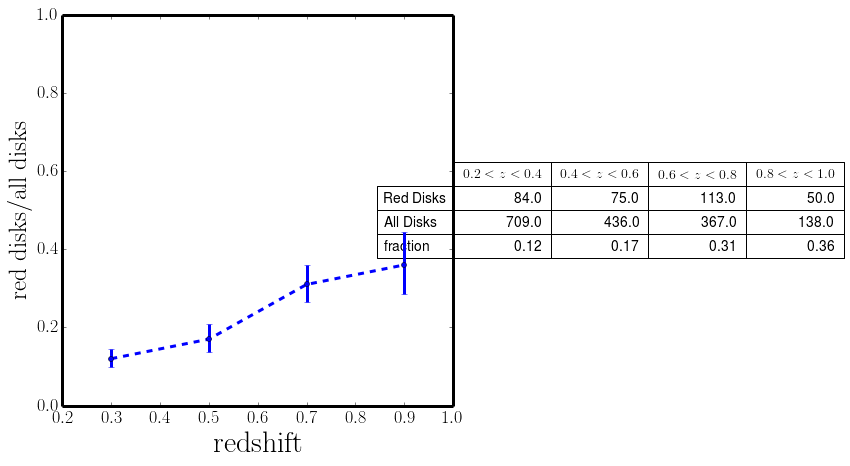

In [11]:
f=figure(figsize=(7,7))
plt.errorbar(reds,frac,yerr=(yl,yh),c='b',fmt='--o',lw=3,ms=5,label='uncorrected')
plt.xlabel('$\mathrm{redshift}$',fontsize=30)
plt.ylabel('$\mathrm{red~disks/all~disks}$',fontsize=25)
plt.xlim(.2,1)
plt.ylim(0,1)
columns = ('$0.2 < z < 0.4$', '$0.4 < z < 0.6$', '$0.6 < z < 0.8$', '$0.8 < z < 1.0$')
rows = ['Red Disks', 'All Disks', 'fraction']
table_data=[Nr,Na,frac]
the_table = plt.table(cellText=table_data,
                      rowLabels=rows,
                      colLabels=columns,
                      loc='right')
the_table.set_fontsize(30)
the_table.scale(1, 2)

plt.savefig('Images/red_disk_fraction_pedge_lt_2.pdf')

In [28]:
def get_image_from_url(url):

    file = cStringIO.StringIO(urllib.urlopen(url).read())
    img = Image.open(file)
    return img
def galaxies_list_red(zl,zh):
    #get list of galaxies within certain ranges of z, mu and p_features 
    these_data=(hubble_data[z]>=zl) & (hubble_data[z] < zh) & blue_disks
    return hubble_data[these_data]
def galaxies_list_blue(zl,zh):
    #get list of galaxies within certain ranges of z, mu and p_features 
    these_data=(hubble_data[z]>=zl) & (hubble_data[z] < zh) & blue_disks
    return hubble_data[these_data]

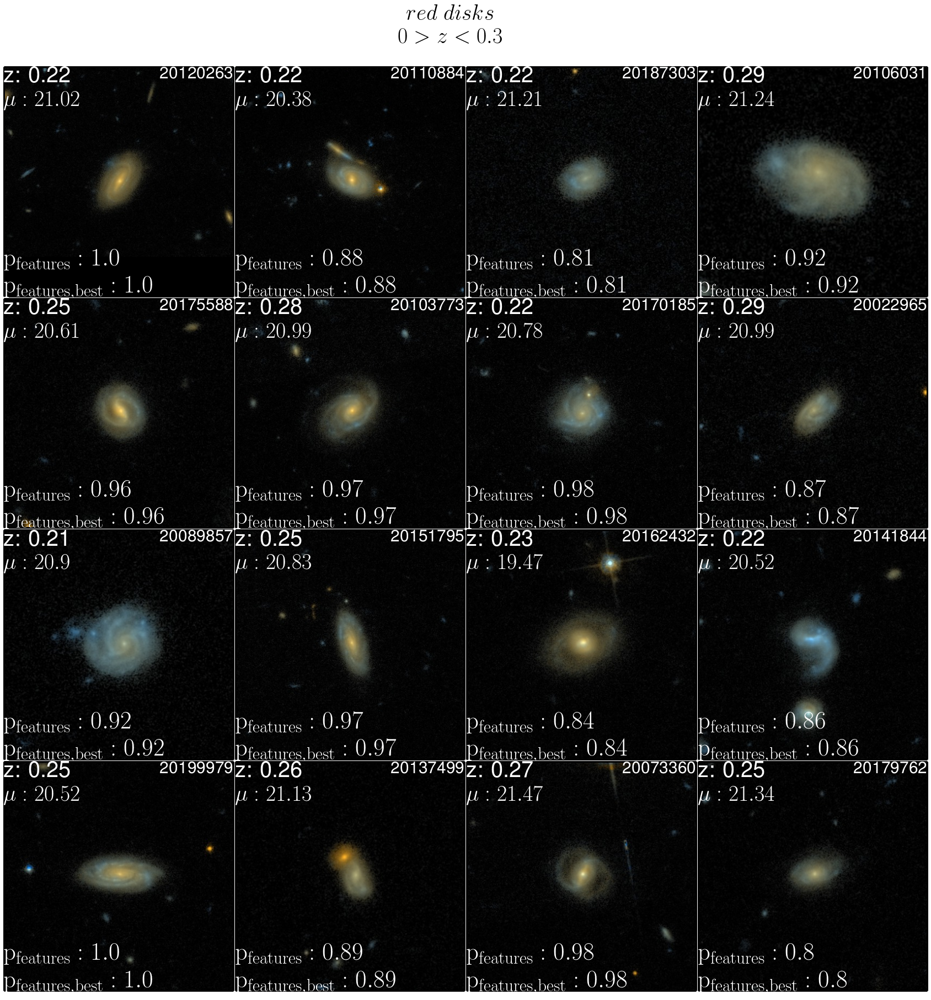

In [30]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=0
zh=.3
 
these_data=galaxies_list_red(zl,zh)

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$red~disks$\n$%s > z < %s$'%(zl,zh), fontsize=40,ha='center')


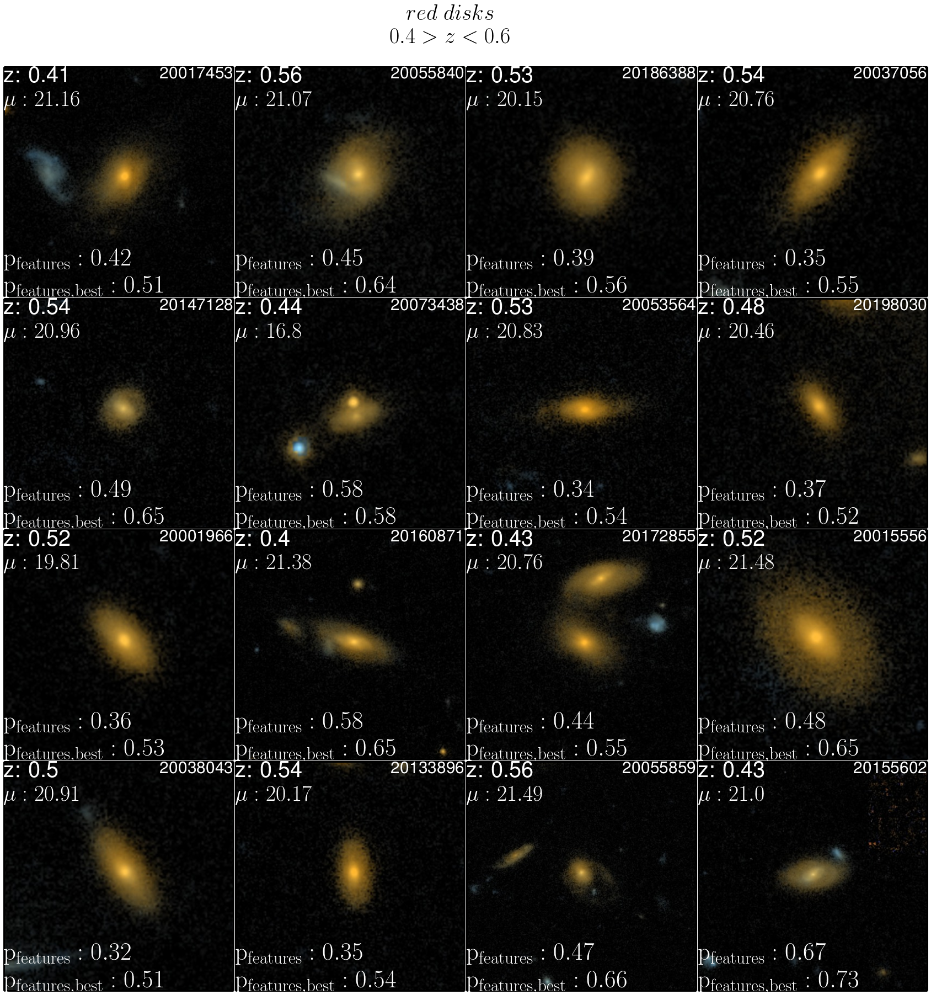

In [58]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.4
zh=.6
 
these_data=galaxies_list_red(zl,zh)

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$red~disks$\n$%s > z < %s$'%(zl,zh), fontsize=40,ha='center')


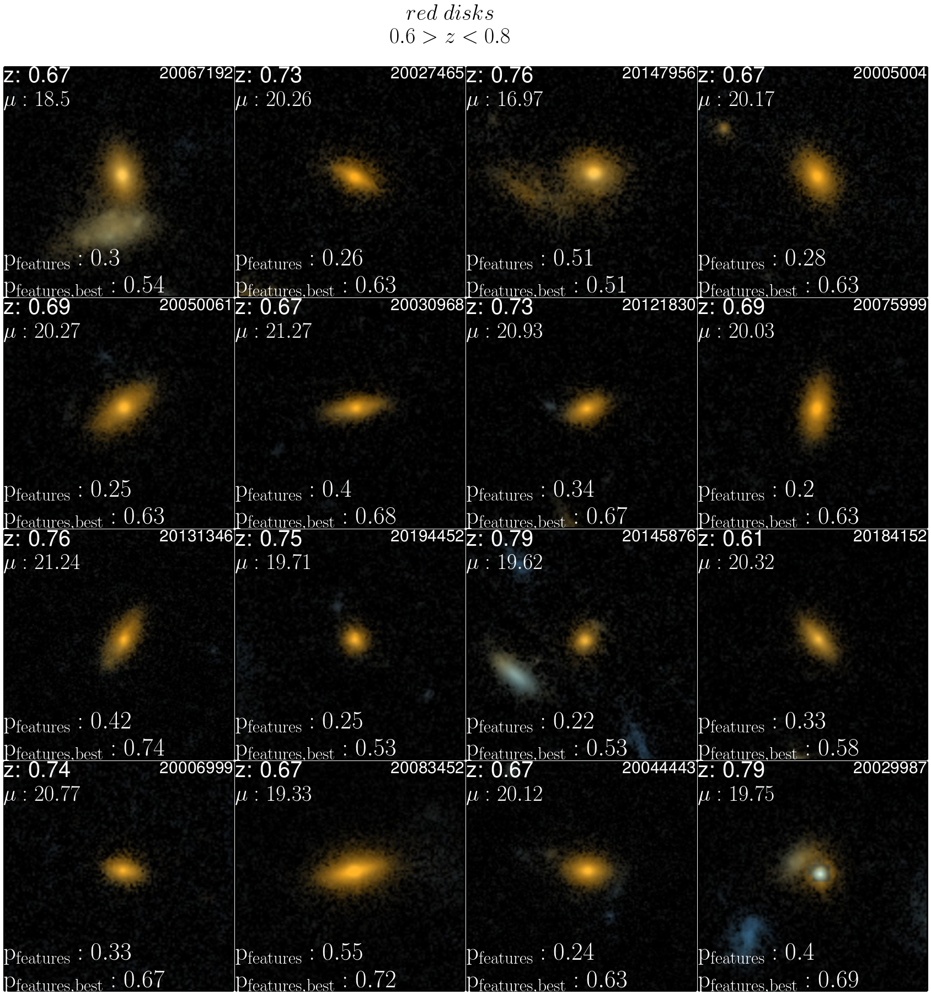

In [59]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.6
zh=.8
 
these_data=galaxies_list_red(zl,zh)

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$red~disks$\n$%s > z < %s$'%(zl,zh), fontsize=40,ha='center')


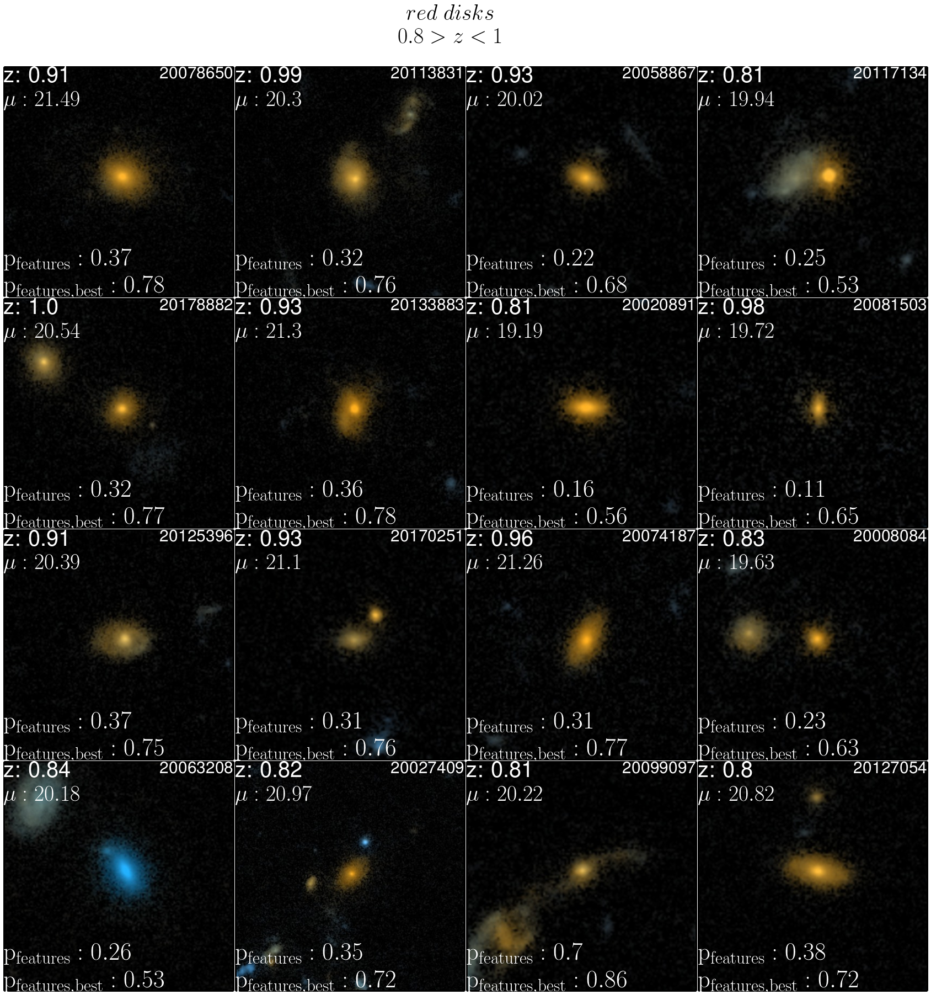

In [60]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.8
zh=1
 
these_data=galaxies_list_red(zl,zh)

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$red~disks$\n$%s > z < %s$'%(zl,zh), fontsize=40,ha='center')


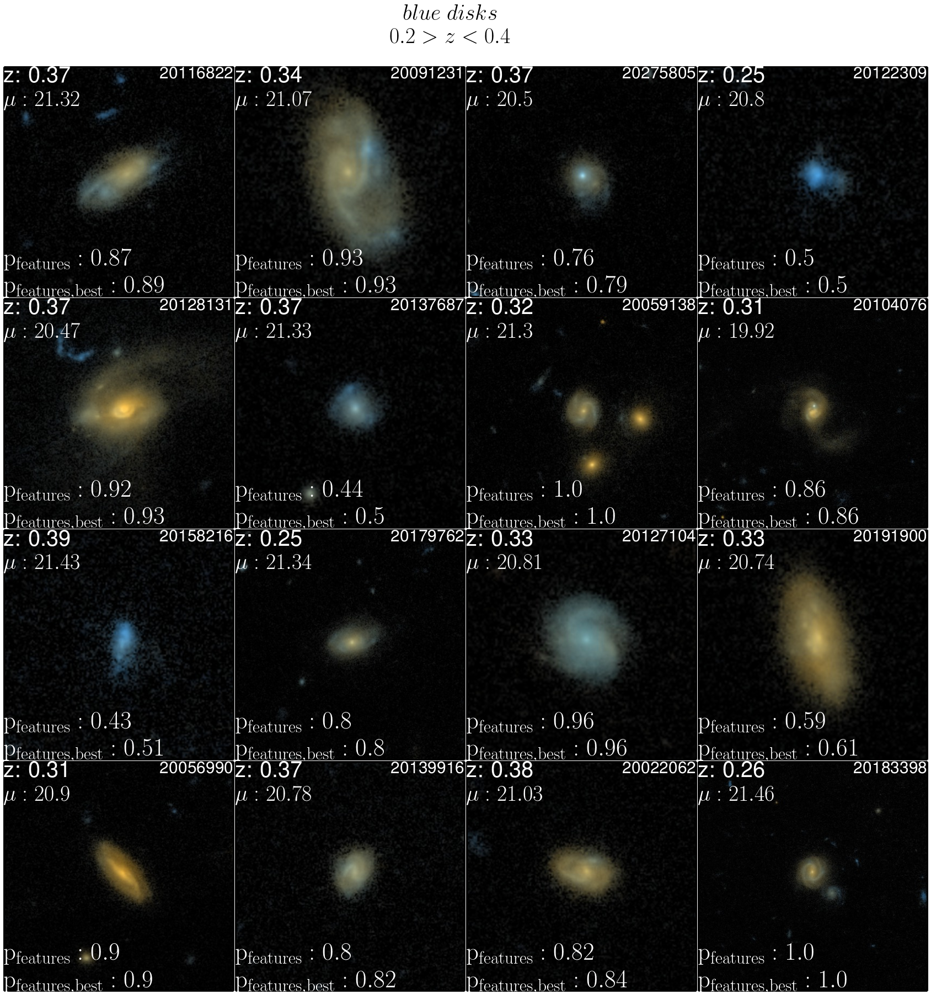

In [41]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.2
zh=.4
 
these_data=galaxies_list_blue(zl,zh)

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$blue~disks$\n$%s > z < %s$'%(zl,zh), fontsize=40,ha='center')


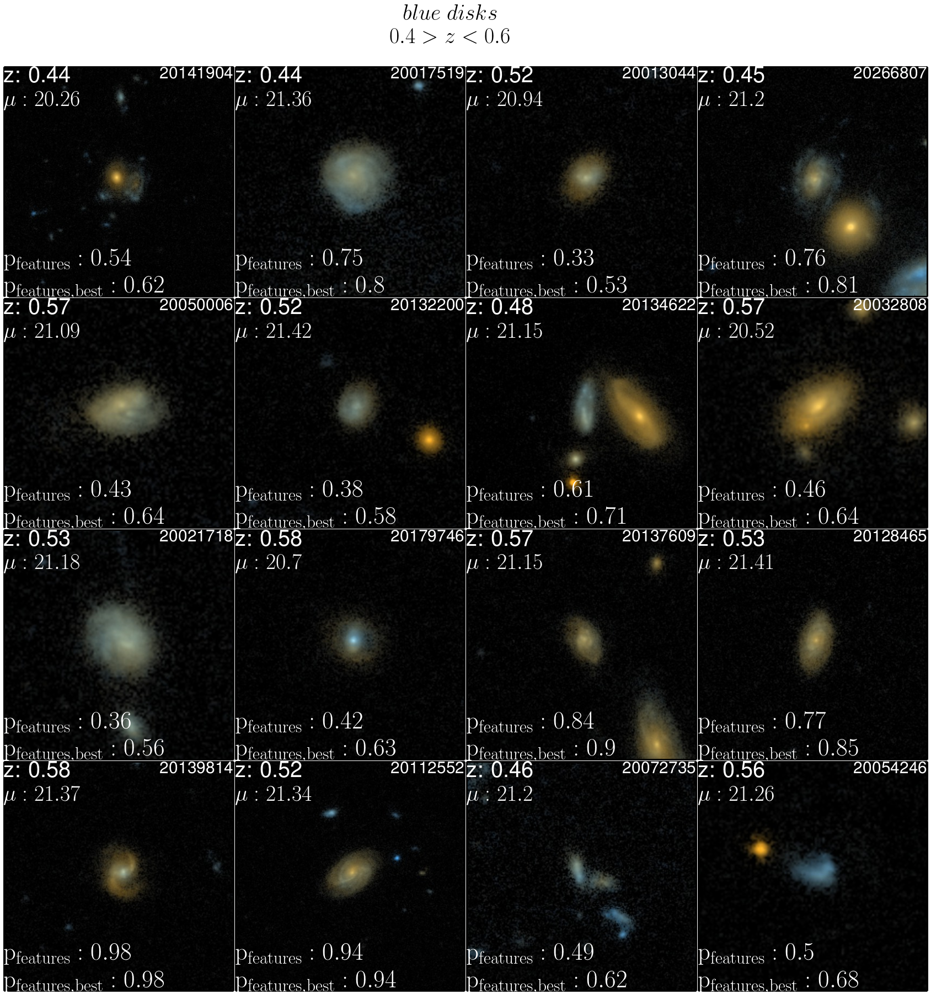

In [42]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.4
zh=.6
 
these_data=galaxies_list_blue(zl,zh)

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$blue~disks$\n$%s > z < %s$'%(zl,zh), fontsize=40,ha='center')


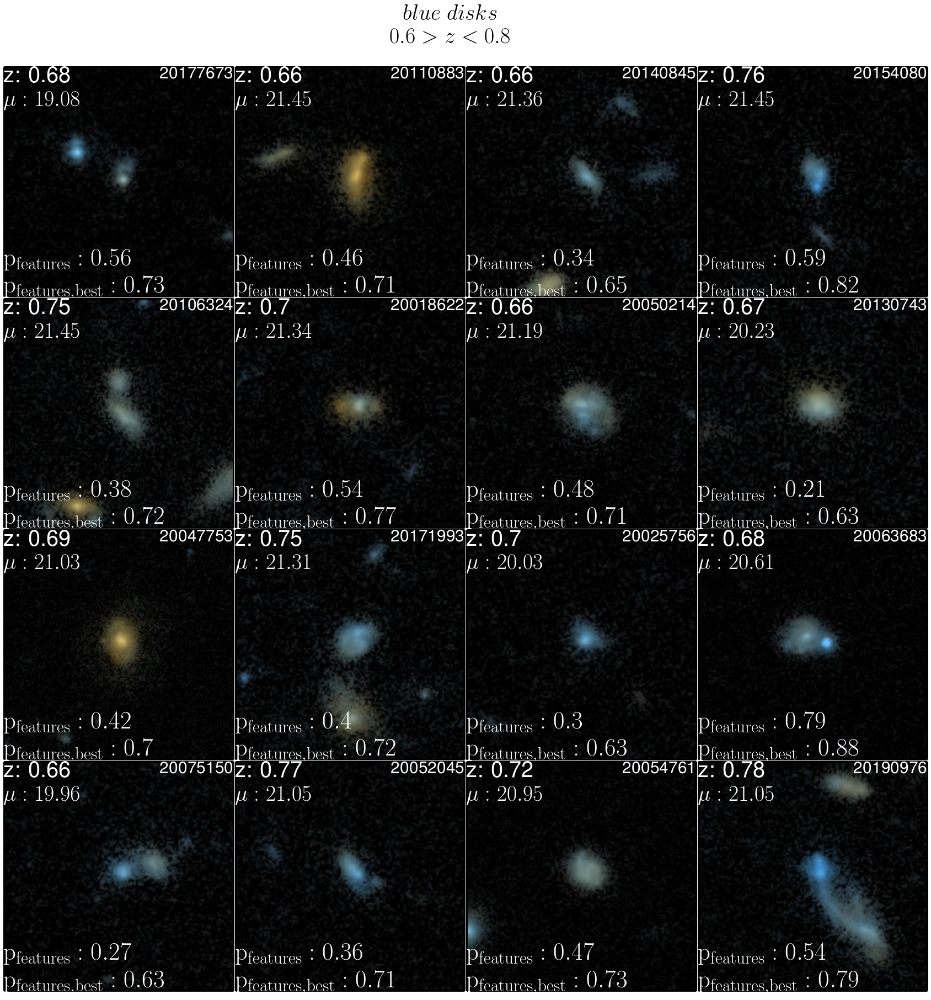

In [58]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.6
zh=.8
 
these_data=galaxies_list_blue(zl,zh)

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$blue~disks$\n$%s > z < %s$'%(zl,zh), fontsize=40,ha='center')


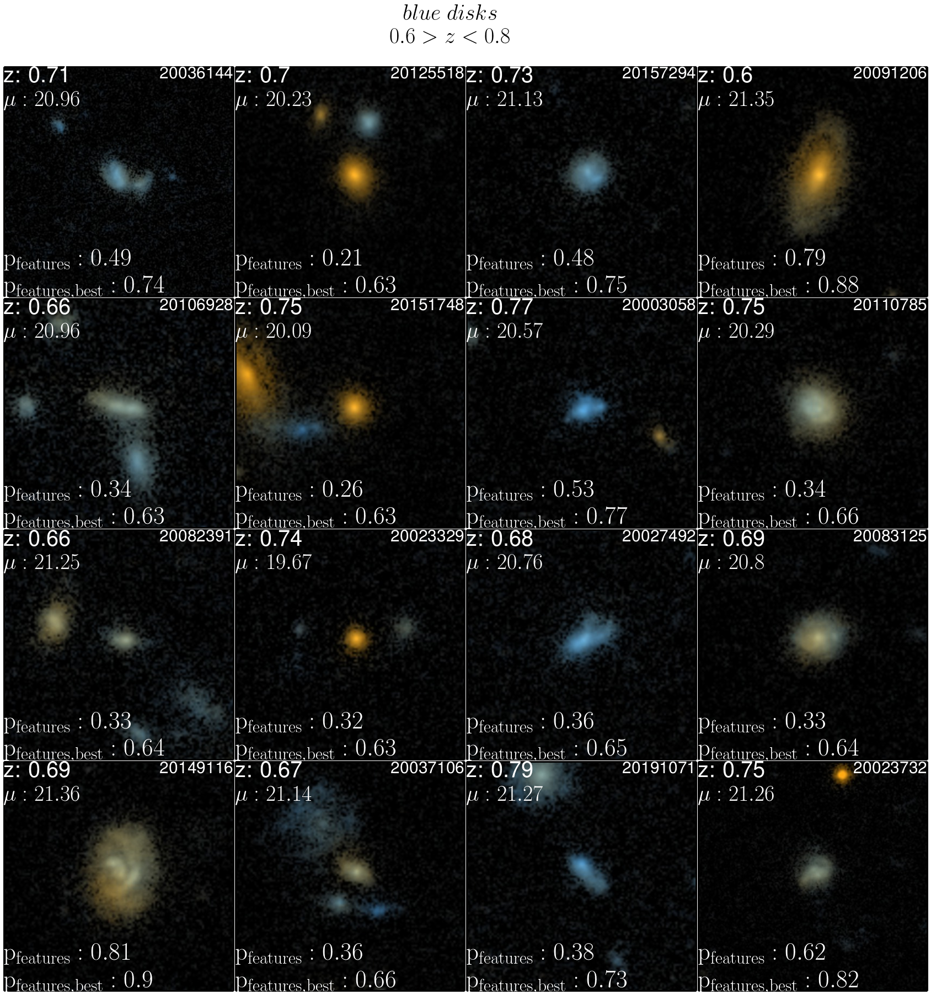

In [59]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.6
zh=.8
 
these_data=galaxies_list_blue(zl,zh)

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$blue~disks$\n$%s > z < %s$'%(zl,zh), fontsize=40,ha='center')


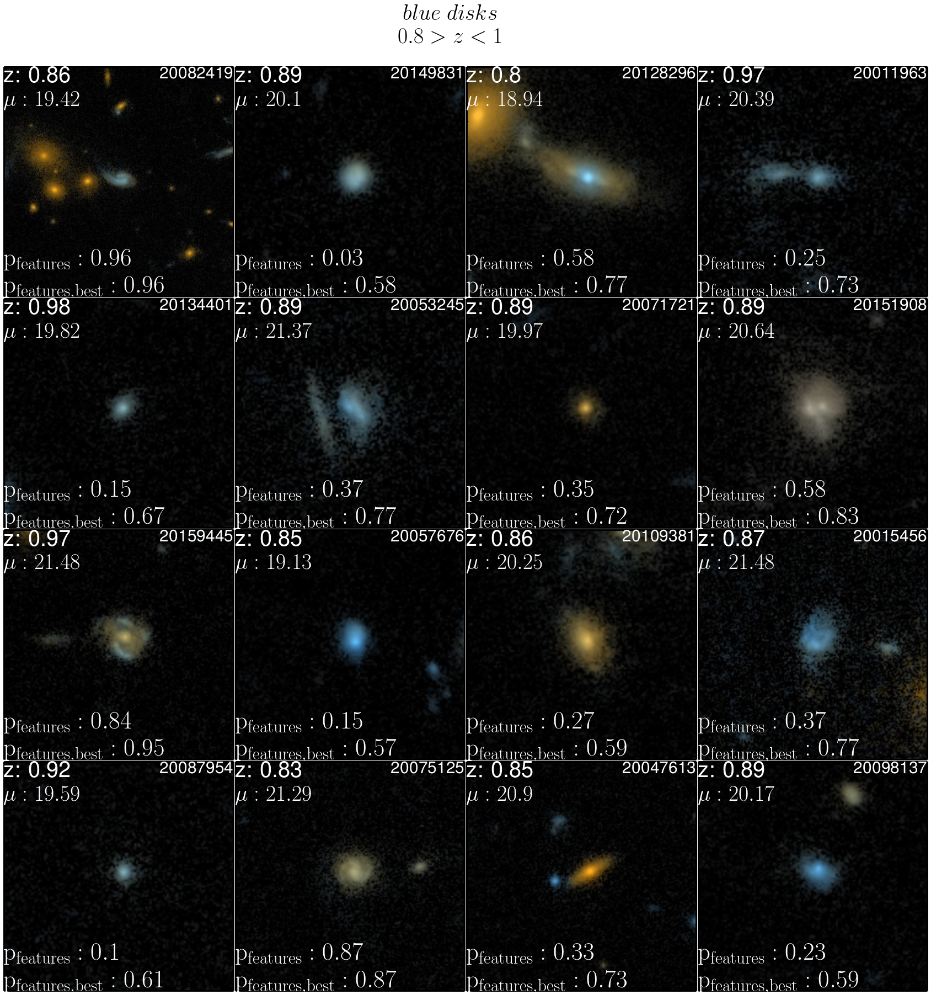

In [60]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.8
zh=1
 
these_data=galaxies_list_blue(zl,zh)

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$blue~disks$\n$%s > z < %s$'%(zl,zh), fontsize=40,ha='center')


In [98]:
weird_blue_gal = (hubble_data['OBJNO_1']==20063208)

(0, 8)

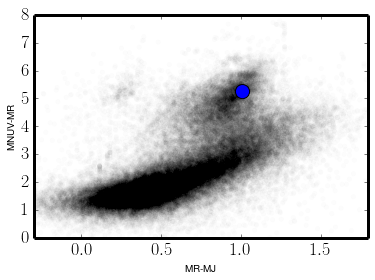

In [108]:
plt.scatter(hubble_data['MR']-hubble_data['MJ'],hubble_data['MNUV']-hubble_data['MR'],alpha=.01,c='k')
plt.scatter(hubble_data[weird_blue_gal]['MR']-hubble_data[weird_blue_gal]['MJ'],hubble_data[weird_blue_gal]['MNUV']-hubble_data[weird_blue_gal]['MR'],s=200,c='b')
plt.xlabel('MR-MJ')
plt.ylabel('MNUV-MR')

plt.xlim(-.3,1.8)
plt.ylim(0,8)

## Check red and all disks sample for non-disk-like features:

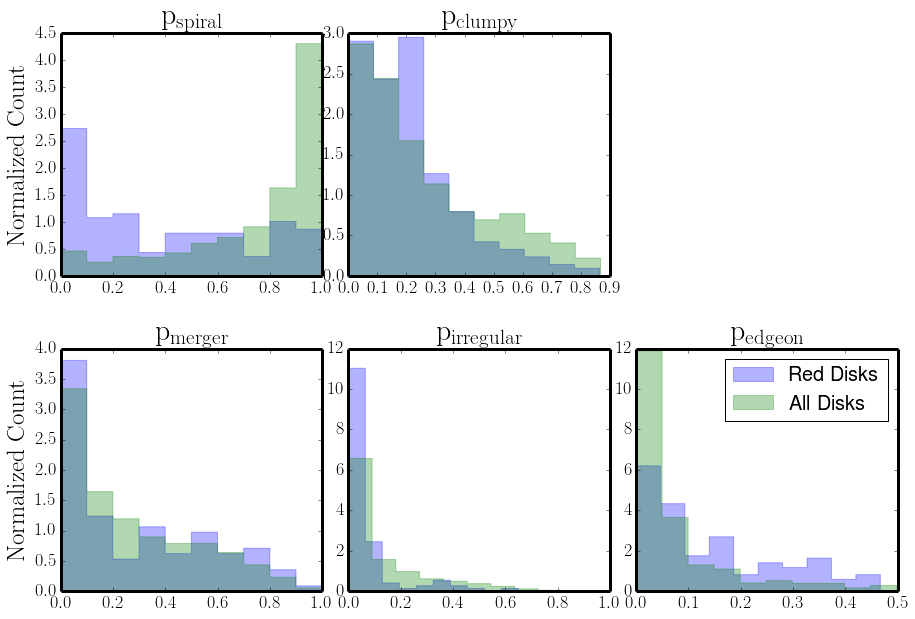

In [61]:


alpha=.3

gs=gridspec.GridSpec(2,3)
gs.update(wspace=0.1)
gs.update(hspace=0.3)

f=plt.figure(figsize=(15,10))

ax1=plt.subplot(gs[0,0])

plt.hist(hubble_data[red_disks & (hubble_data[N_spiral]>10)][p_spiral],histtype='step',fill=True,alpha=alpha,normed=True,label='Red Disks')
plt.hist(hubble_data[all_disks & (hubble_data[N_spiral]>10)][p_spiral],histtype='step',fill=True,alpha=alpha,normed=True,label='All Disks')
plt.ylabel('$\mathrm{Normalized~Count}$',fontsize=25)
plt.title('$\mathrm{p_{spiral}}$',fontsize=30)

ax1=plt.subplot(gs[0,1])

plt.hist(hubble_data[red_disks & (hubble_data[N_clumpy]>10)][p_clumpy],histtype='step',fill=True,alpha=alpha,normed=True,label='Red Disks')
plt.hist(hubble_data[all_disks & (hubble_data[N_clumpy]>10)][p_clumpy],histtype='step',fill=True,alpha=alpha,normed=True,label='All Disks')

plt.title('$\mathrm{p_{clumpy}}$',fontsize=30)

ax1=plt.subplot(gs[1,0])

plt.hist(hubble_data[red_disks & (hubble_data[N_odd]>10)][p_merger],histtype='step',fill=True,alpha=alpha,normed=True,label='Red Disks')
plt.hist(hubble_data[all_disks & (hubble_data[N_odd]>10)][p_merger],histtype='step',fill=True,alpha=alpha,normed=True,label='All Disks')
plt.title('$\mathrm{p_{merger}}$',fontsize=30)
plt.ylabel('$\mathrm{Normalized~Count}$',fontsize=25)

ax1=plt.subplot(gs[1,1])

plt.hist(hubble_data[red_disks & (hubble_data[N_odd]>10)][p_irregular],histtype='step',fill=True,alpha=alpha,normed=True,label='Red Disks')
plt.hist(hubble_data[all_disks & (hubble_data[N_odd]>10)][p_irregular],histtype='step',fill=True,alpha=alpha,normed=True,label='All Disks')
plt.title('$\mathrm{p_{irregular}}$',fontsize=30)

ax1=plt.subplot(gs[1,2])

plt.hist(hubble_data[red_disks & (hubble_data[N_edge]>10)][p_edgeon],histtype='step',fill=True,alpha=alpha,normed=True,label='Red Disks')
plt.hist(hubble_data[all_disks & (hubble_data[N_edge]>10)][p_edgeon],histtype='step',fill=True,alpha=alpha,normed=True,label='All Disks')
plt.title('$\mathrm{p_{edgeon}}$',fontsize=30)
plt.legend(fontsize=20)

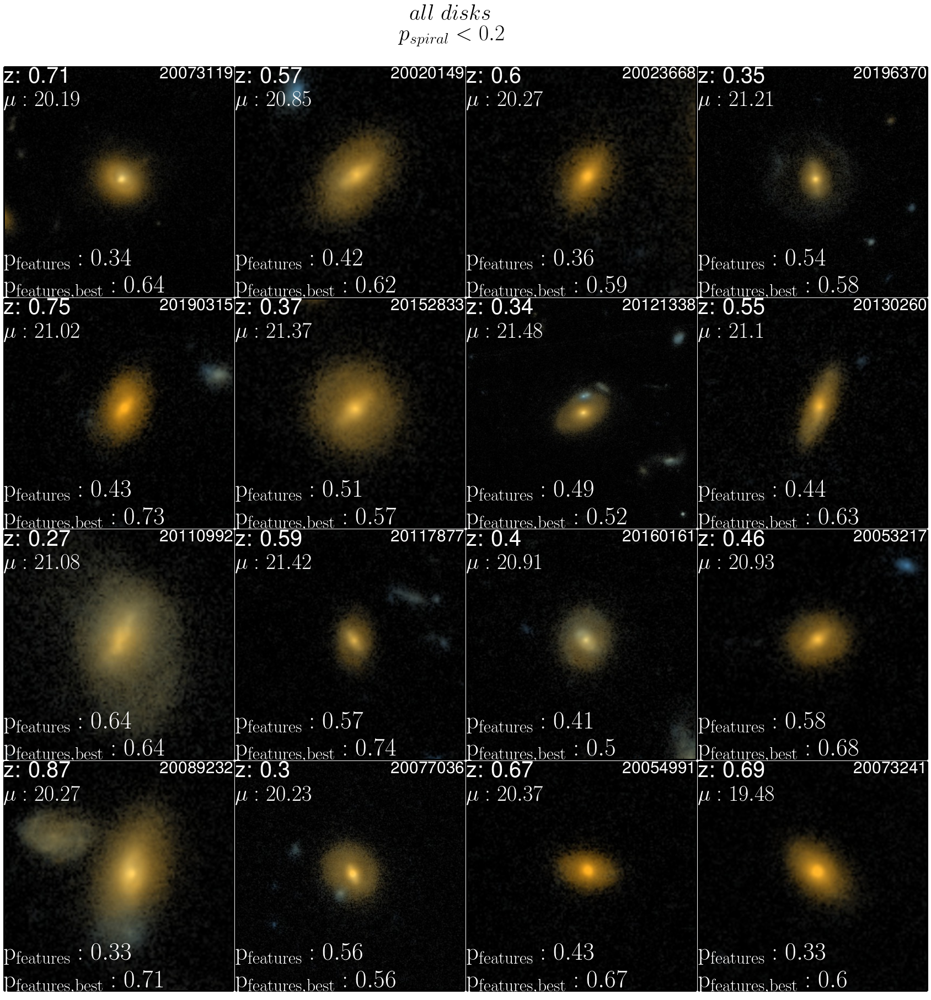

In [44]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.8
zh=1
p_spiral_cut=.2
 
these_data=hubble_data[all_disks & (hubble_data[N_spiral]>10) & (hubble_data[p_spiral]<p_spiral_cut)]

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$all~disks$\n$p_{spiral} < %s$'%p_spiral_cut, fontsize=40,ha='center')


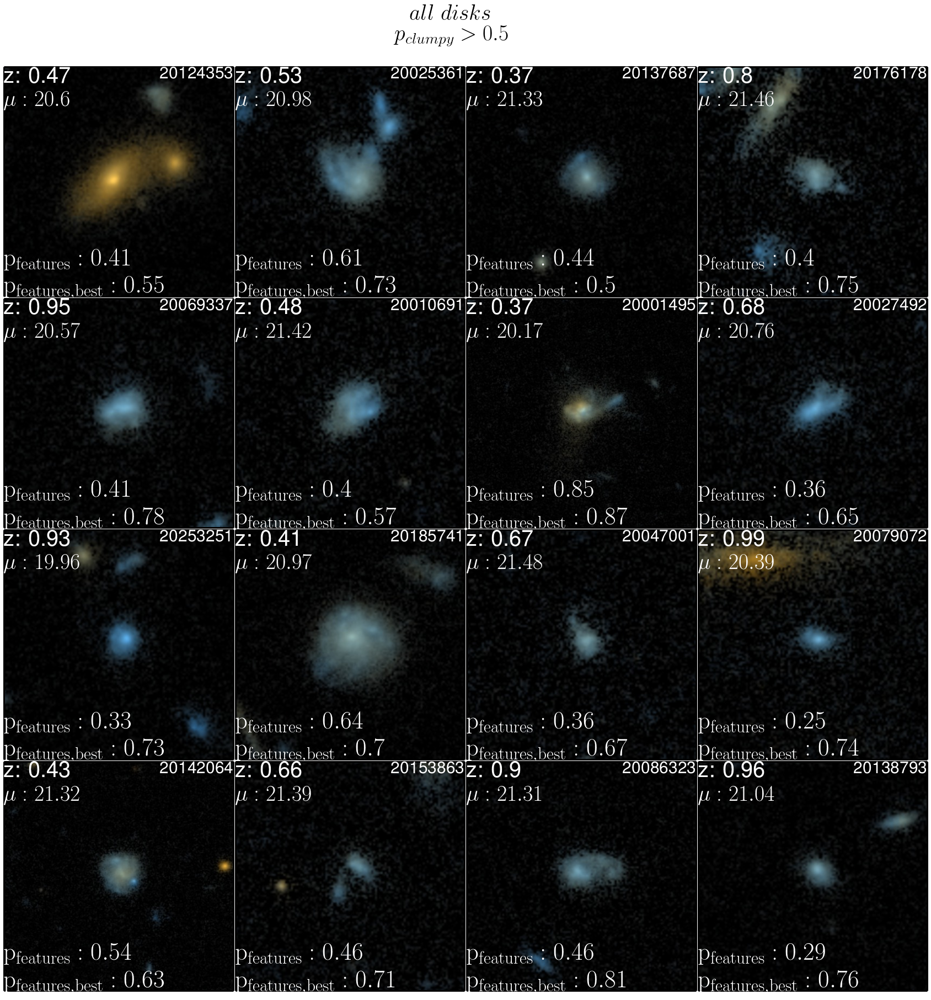

In [45]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.8
zh=1

p_clumpy_cut=.5
 
these_data=hubble_data[all_disks & (hubble_data[N_clumpy]>10) & (hubble_data[p_clumpy]>p_clumpy_cut)]

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$all~disks$\n$p_{clumpy} > %s$'%p_clumpy_cut, fontsize=40,ha='center')


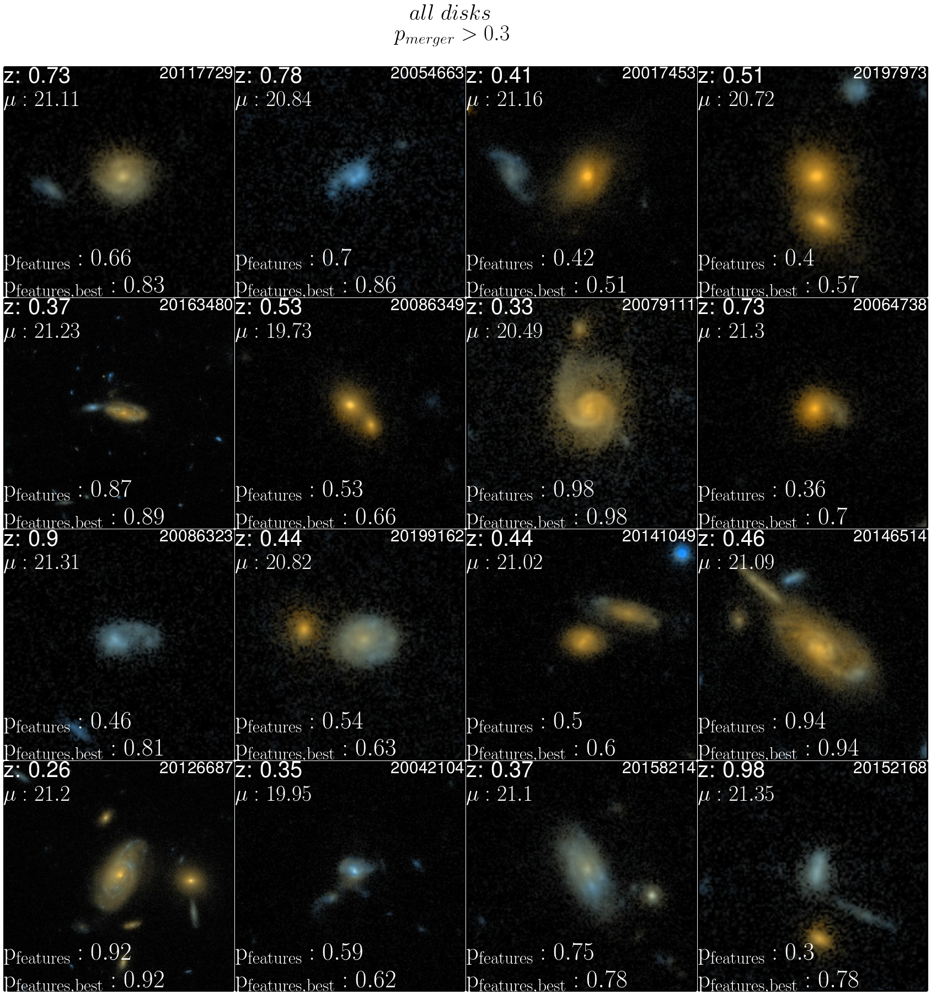

In [46]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.8
zh=1

p_merger_cut = .3

these_data=hubble_data[all_disks & (hubble_data[N_odd]>10) & (hubble_data[p_merger]>p_merger_cut)]

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$all~disks$\n$p_{merger} > %s$'%p_merger_cut, fontsize=40,ha='center')


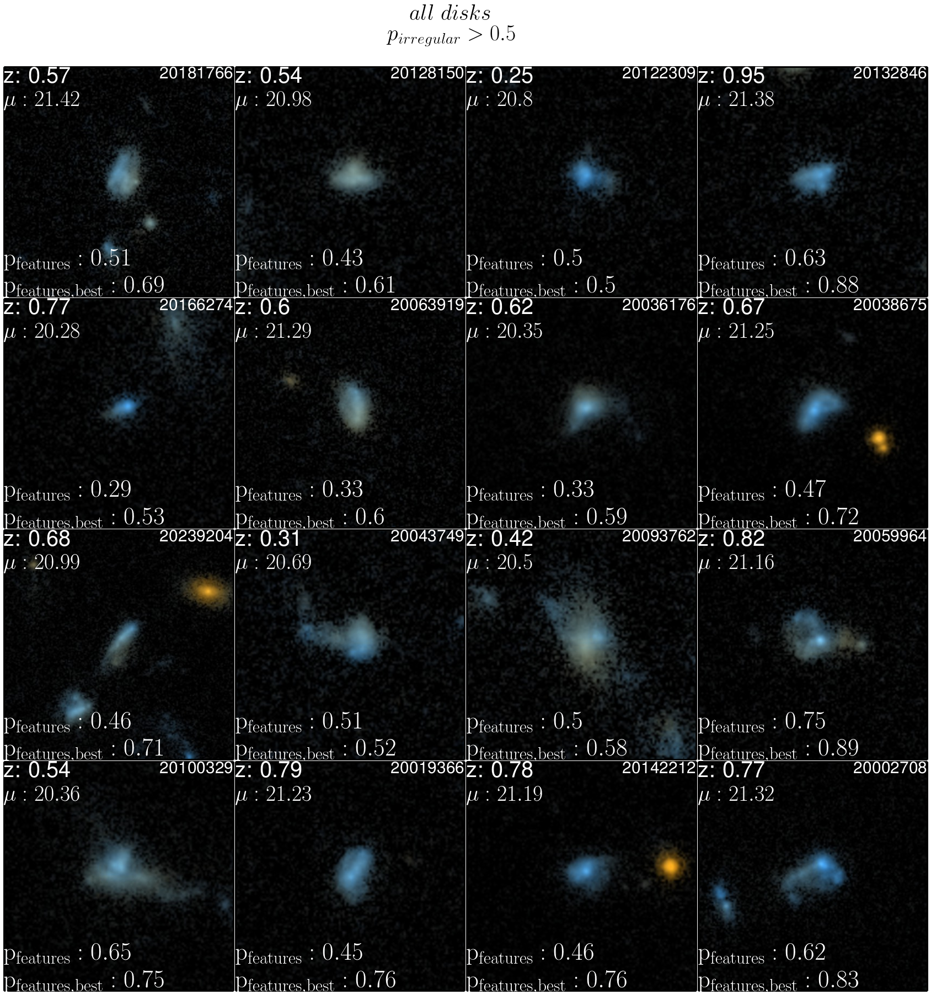

In [89]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.8
zh=1

p_irr_cut=.5
 
these_data=hubble_data[all_disks & (hubble_data[N_odd]>10) & (hubble_data[p_irregular]>p_irr_cut)]

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$all~disks$\n$p_{irregular} > %s$'%p_irr_cut, fontsize=40,ha='center')


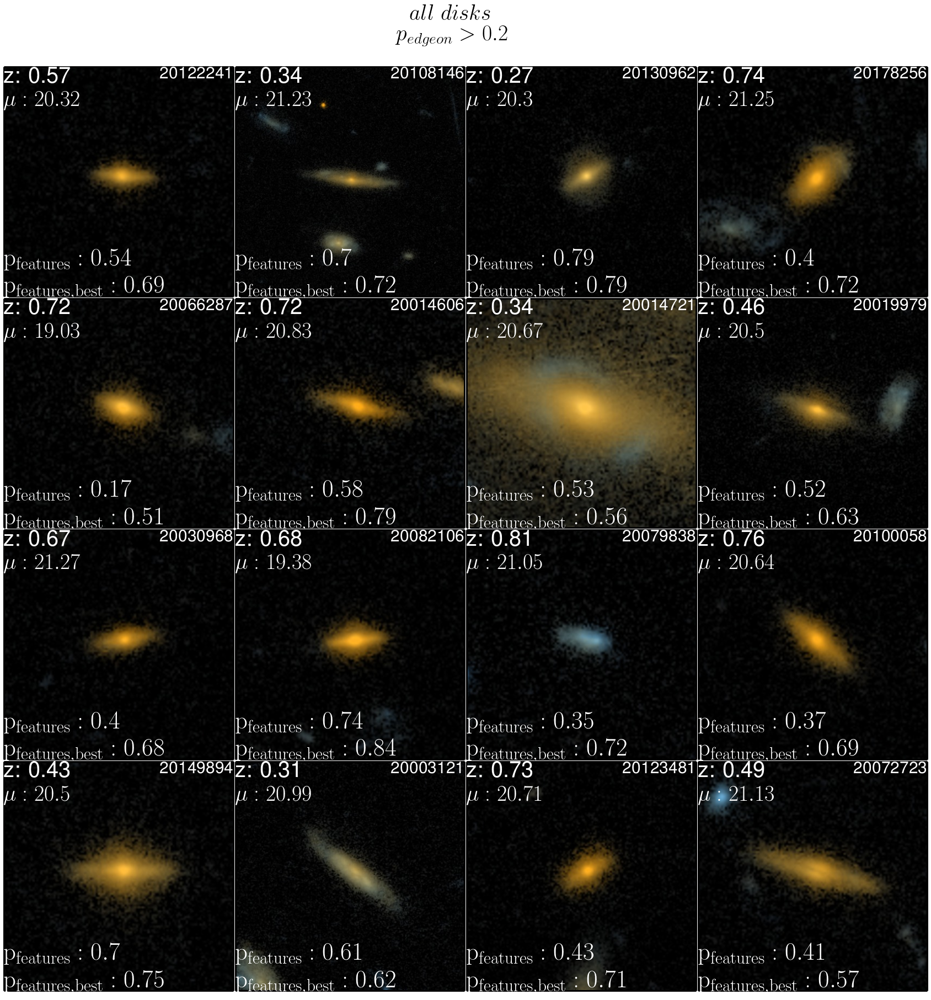

In [192]:
gs=gridspec.GridSpec(4,4)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

zl=.8
zh=1

p_edge_cut=.2
 
these_data=hubble_data[all_disks & (hubble_data[p_edgeon]>p_edge_cut)]

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
shuffle(n_list)

f=plt.figure(figsize=(30,30))
n=0
for i in range (0,4):
    for j in range(0,4):
        ax=plt.subplot(gs[i,j])
        while 'h' not in these_data[int(n_list[n])]['location']:
            n+=1
        gal = these_data[int(n_list[n])] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('z: %s\n$\mu: %s$'%(round(gal[z],2),round(gal['MU_HI'],2)),fontsize=40,xy=(0,1),
            xycoords='axes fraction',verticalalignment='top',color='white')
        ax.annotate('%s'%gal['OBJNO_1'],fontsize=30,xy=(1,1),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')
        ax.annotate('$\mathrm{p_{features}: %s}$\n$\mathrm{p_{features,best}: %s}$'%(round(gal['t01_smooth_or_features_a02_features_or_disk_weighted_fraction'],2),round(gal['t01_smooth_or_features_a02_features_or_disk_best_fraction'],2)),fontsize=45,xy=(0,0),
            xycoords='axes fraction',color='white')
        n+=1
        

f.text(.5,.92,'$all~disks$\n$p_{edgeon} > %s$'%p_edge_cut, fontsize=40,ha='center')


## Edge on stuff

In [12]:
def Hist3D(xedges,yedges,the_data,colorhist):
    newmatrix = np.zeros(shape=(len(yedges)-1,len(xedges)-1))
    for i in range(0,len(yedges)-1):
        for j in range(0,len(xedges)-1):
            data_i_j = (the_data['MNUV']-the_data['MR']>=yedges[i]) & (the_data['MNUV']-the_data['MR'] < yedges[i+1]) & (the_data['MR']-the_data['MJ']>=xedges[j]) & (the_data['MR']-the_data['MJ']<xedges[j+1])
            newmatrix[i,j]=np.nanmean(the_data[data_i_j][p_edgeon])
    newmatrix=ma.masked_where(colorhist.T<10,newmatrix)
    return newmatrix

In [55]:
p_cut=.6
pec=(hubble_data[p_edgeon]<=p_cut) 

#all disks
colorhist,xedge,yedge = np.histogram2d(hubble_data[all_disks]['MR']-hubble_data[all_disks]['MJ'],hubble_data[all_disks]['MNUV']-hubble_data[all_disks]['MR'],bins=(15,15))
extent=[xedge[0],xedge[-1],yedge[0],yedge[-1]]
this_hist=Hist3D(xedge,yedge,hubble_data[all_disks],colorhist)

colorhist_contour,xedge_contour,yedge_contour = np.histogram2d(hubble_data[all_disks]['MR']-hubble_data[all_disks]['MJ'],hubble_data[all_disks]['MNUV']-hubble_data[all_disks]['MR'],bins=(20,20))
extent_contour=[xedge_contour[0],xedge_contour[-1],yedge_contour[0],yedge_contour[-1]]


N_passive = len(hubble_data[red_disks])
N_SF = len(hubble_data[all_disks]) - N_passive

#face-on disks
colorhist_pec,xedge_pec,yedge_pec = np.histogram2d(hubble_data[all_disks & pec]['MR']-hubble_data[all_disks & pec]['MJ'],hubble_data[all_disks & pec]['MNUV']-hubble_data[all_disks & pec]['MR'],bins=(15,15))
extent_pec=[xedge_pec[0],xedge_pec[-1],yedge_pec[0],yedge_pec[-1]]
this_hist_pec=Hist3D(xedge_pec,yedge_pec,hubble_data[all_disks & pec],colorhist_pec)

colorhist_contour_pec,xedge_contour_pec,yedge_contour_pec = np.histogram2d(hubble_data[all_disks & pec]['MR']-hubble_data[all_disks & pec]['MJ'],hubble_data[all_disks & pec]['MNUV']-hubble_data[all_disks & pec]['MR'],bins=(20,20))
extent_contour_pec=[xedge_contour_pec[0],xedge_contour_pec[-1],yedge_contour_pec[0],yedge_contour_pec[-1]]

N_passive_pec = len(hubble_data[red_disks & pec])
N_SF_pec = len(hubble_data[all_disks & pec]) - N_passive_pec


mpl.rcParams['xtick.labelsize'] = 18
mpl.rcParams['ytick.labelsize'] = 18 

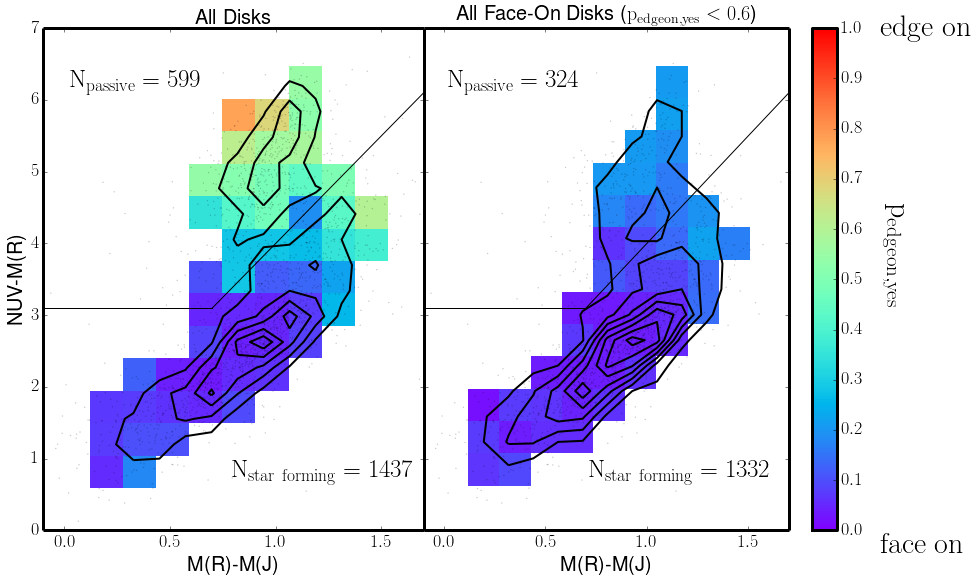

In [62]:
f=plt.figure(figsize=(15,9))
gs=gridspec.GridSpec(1,2,width_ratios=[1,1.2])
gs.update(wspace=0)


cmap=cm.rainbow
alpha=.3

x1=np.linspace(-5,.7,100)
x2=np.linspace(.7,5,100)


ax=plt.subplot(gs[0,0])

plt.scatter(hubble_data[all_disks]['MR']-hubble_data[all_disks]['MJ'],hubble_data[all_disks]['MNUV']-hubble_data[all_disks]['MR'],s=.1,alpha=alpha)
plt.contour(colorhist_contour.T,extent=extent,colors='k',linewidths=2)
plt.imshow(this_hist,origin='lower',extent=extent_contour,interpolation='nearest',cmap=cmap,vmin=0,vmax=1,aspect='auto')
plt.ylim(0,7)
plt.xlim(-.1,1.7)
plt.ylabel('NUV-M(R)',fontsize=20)
plt.xlabel('M(R)-M(J)',fontsize=20)
plt.plot(x1,3.1+0*x1,c='k')
plt.plot(x2,3*x2+1,c='k')
plt.title('All Disks',fontsize=20)

ax=plt.subplot(gs[0,1])

plt.scatter(hubble_data[all_disks & pec]['MR']-hubble_data[all_disks & pec]['MJ'],hubble_data[all_disks & pec]['MNUV']-hubble_data[all_disks & pec]['MR'],s=.1,alpha=alpha)
plt.contour(colorhist_contour_pec.T,extent=extent_pec,colors='k',linewidths=2)
plt.imshow(this_hist_pec,origin='lower',extent=extent_contour_pec,interpolation='nearest',cmap=cmap,vmin=0,vmax=1,aspect='auto')
plt.ylim(0,7)
plt.xlim(-.1,1.7)
plt.xlabel('M(R)-M(J)',fontsize=20)
plt.tick_params(labelleft='off')
plt.plot(x1,3.1+0*x1,c='k')
plt.plot(x2,3*x2+1,c='k')
plt.title('All Face-On Disks ($\mathrm{p_{edgeon,yes}<%s}$)'%p_cut,fontsize=20)


plt.colorbar()
f.text(.9,.55,r'$\mathrm{p_{edgeon,yes}}$',rotation=270,fontsize=30,va='center')
f.text(.9,.1,r'$\mathrm{face~on}$',fontsize=30,va='center')
f.text(.9,.9,r'$\mathrm{edge~on}$',fontsize=30,va='center')
plt.savefig('Poster_Images/red_sequence_selection.eps',format='eps',dpi=1000)

#numbers
f.text(.15,.8,r'$\mathrm{N_{passive}=%s}$'%N_passive,fontsize=25)
f.text(.3,.2,r'$\mathrm{N_{star~forming}=%s}$'%N_SF,fontsize=25)

f.text(.5,.8,r'$\mathrm{N_{passive}=%s}$'%N_passive_pec,fontsize=25)
f.text(.63,.2,r'$\mathrm{N_{star~forming}=%s}$'%N_SF_pec,fontsize=25)




In [62]:
p_edge_cut=(hubble_data[p_edgeon]<.4)

colorhist,xedge,yedge = np.histogram2d(hubble_data[all_disks & p_edge_cut]['MR']-hubble_data[all_disks & p_edge_cut]['MJ'],hubble_data[all_disks & p_edge_cut]['MNUV']-hubble_data[all_disks & p_edge_cut]['MR'],bins=(15,15))
extent=[xedge[0],xedge[-1],yedge[0],yedge[-1]]
this_hist=Hist3D(xedge,yedge,hubble_data[all_disks & p_edge_cut],colorhist)

colorhist_contour,xedge_contour,yedge_contour = np.histogram2d(hubble_data[all_disks & p_edge_cut]['MR']-hubble_data[all_disks & p_edge_cut]['MJ'],hubble_data[all_disks & p_edge_cut]['MNUV']-hubble_data[all_disks & p_edge_cut]['MR'],bins=(20,20))
extent_contour=[xedge_contour[0],xedge_contour[-1],yedge_contour[0],yedge_contour[-1]]


mpl.rcParams['xtick.labelsize'] = 18
mpl.rcParams['ytick.labelsize'] = 18 

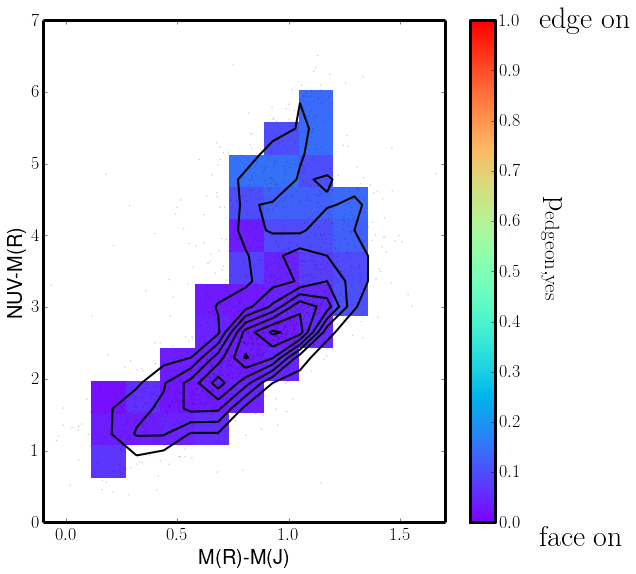

In [63]:
f=plt.figure(figsize=(9,9))

cmap=cm.rainbow
alpha=.3


plt.scatter(hubble_data[all_disks]['MR']-hubble_data[all_disks]['MJ'],hubble_data[all_disks]['MNUV']-hubble_data[all_disks]['MR'],s=.1,alpha=alpha)
plt.contour(colorhist_contour.T,extent=extent,colors='k',linewidths=2)
plt.imshow(this_hist,origin='lower',extent=extent_contour,interpolation='nearest',cmap=cmap,vmin=0,vmax=1,aspect='auto')
plt.ylim(0,7)
plt.xlim(-.1,1.7)
plt.ylabel('NUV-M(R)',fontsize=20)
plt.xlabel('M(R)-M(J)',fontsize=20)
plt.colorbar()
f.text(.89,.55,r'$\mathrm{p_{edgeon,yes}}$',rotation=270,fontsize=30,va='center')
f.text(.89,.1,r'$\mathrm{face~on}$',fontsize=30,va='center')
f.text(.89,.9,r'$\mathrm{edge~on}$',fontsize=30,va='center')
plt.savefig('Images/edge_fraction_over_color.pdf')